C:\Users\alessandro.lorusso\AppData\Local\Temp\ipykernel_39060\958346536.py:91: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  kf.update(float(dPdV))
Animation size has reached 21047646 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


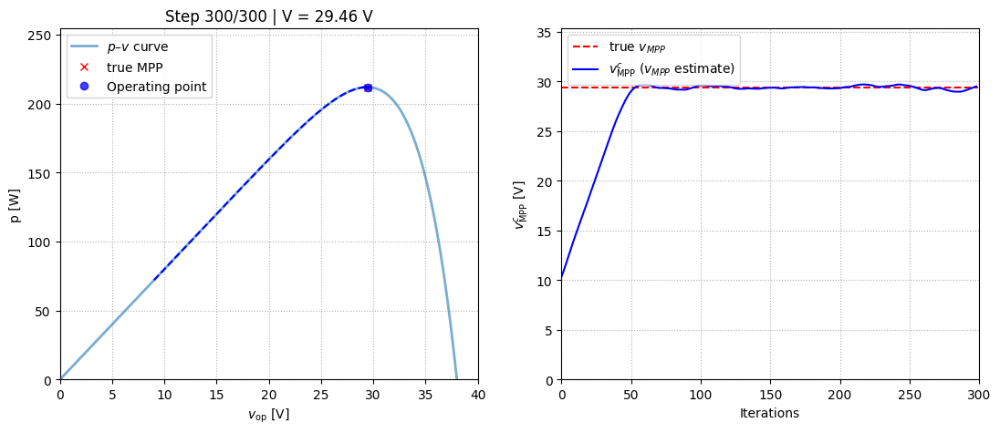

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML
# ==========================================================
# PV MODEL
# ==========================================================
def pv_model(V, Isc=8, Voc=38.0, n=9):
    V = np.atleast_1d(V).astype(float)
    V = np.clip(V, 0, Voc)
    I = Isc * (1 - (V / Voc) ** n)
    I[I < 0] = 0
    P = V * I
    return I, P

# ==========================================================
# KALMAN FILTER MPPT
# ==========================================================
class KalmanMPPT:
    
    def __init__(self):
        self.x = np.zeros((2, 1))
        self.P = np.eye(2)
        self.A = np.eye(2)
        self.H = np.array([[1.0, 0.0]])
        self.Q = np.eye(2) * 1e-3
        self.R = np.array([[5e-2]])
        
    def predict(self):
        self.x = self.A @ self.x
        self.P = self.A @ self.P @ self.A.T + self.Q
        
    def update(self, z):
        z = np.array([[z]], dtype=float)
        y = z - self.H @ self.x
        S = self.H @ self.P @ self.H.T + self.R
        K = self.P @ self.H.T @ np.linalg.inv(S)
        self.x = self.x + K @ y
        self.P = (np.eye(2) - K @ self.H) @ self.P
        

# ==========================================================
# SIMULATION
# ==========================================================
def simulate(Isc=8.0, Voc=38.0, n=9):
    Vplot = np.linspace(0, Voc, 600)
    _, Pplot = pv_model(Vplot, Isc, Voc, n)
    idx_mpp = np.argmax(Pplot)
    Vtrue_mpp, Ptrue_mpp = Vplot[idx_mpp], Pplot[idx_mpp]
    
    #Initialization and parametrization
    Voper = 9
    V_MPP_est_0 = 10
    
    #Kalman filter initialization
    kf = KalmanMPPT()
    power_meas_noise_variance = 0.05
    kf.x[1, 0] = V_MPP_est_0
    alpha = 0.05 #"learning rate" in the v_MPP estimation
    #matrix to apply for the v_MPP estimation
    C = np.array([[1.0, 0.0],
              [alpha, 1.0]], dtype=float)
    
    beta = 0.5
    #Voltage variation for gradient estimation
    delta_v = 0.2
    
    #Initialization of the arrays of operating voltage, power at the operating voltage and MPP voltage estimation respectilvely
    Vhist, Phist, Vest_hist = [], [], []
    
    #Simulation run for 300 iterations
    for _ in range(300):
        
        _, P = pv_model(Voper, Isc, Voc, n)
        _, Pp = pv_model(Voper + delta_v, Isc, Voc, n)
        
        #power measurement with noise
        P_noise = P + np.random.normal(0, np.sqrt(power_meas_noise_variance))
        Pp_noise = Pp + np.random.normal(0, np.sqrt(power_meas_noise_variance))
        
        #Gradient computation
        dPdV = (Pp_noise - P_noise) / (delta_v)
        
        #store the voper before new update (for chart population)
        Voper_prev = Voper
        
        #Kalman predict
        kf.predict()
        
        #Kalman update
        kf.update(float(dPdV))
        
        # MPP estimate update (system state by applying the matrix C)
        kf.x = C @ kf.x
        
        Voper = Voper + beta * (kf.x[1, 0] - Voper)
        
        Voper = float(np.clip(Voper, 0, Voc))
        
        Vhist.append(Voper_prev)
        
        Phist.append(float(P[0]))
        
        Vest_hist.append(float(kf.x[1, 0]))
        
    return Vplot, Pplot, Vhist, Phist, Vest_hist, Vtrue_mpp, Ptrue_mpp


# ==========================================================
# ANIMATION (P-V curve) + FIGURE 9 (V_est vs V_mpp)
# ==========================================================
Vplot, Pplot, Vhist, Phist, Vest_hist, Vtrue_mpp, Ptrue_mpp = simulate()

# --- Figure 1: P-V with operation point ---
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(13, 5))
ax1.plot(Vplot, Pplot, label=r"$p$–$v$ curve", lw=2,alpha=0.6)
ax1.plot([Vtrue_mpp], [Ptrue_mpp], "rx", label="true MPP")
pt, = ax1.plot([], [], "bo", label="Operating point",alpha=0.75)
trace, = ax1.plot([], [], "b--")
ax1.set_xlim(0, 40)
ax1.set_ylim(0, np.max(Pplot) * 1.2)
ax1.set_xlabel(r"$v_{\mathrm{op}}$ [V]")
ax1.set_ylabel("p [W]")
ax1.legend()
ax1.grid(True, ls=':')

# --- Figure 2: V_est vs V_mpp (similar to figure 9 in the tutorial) ---
ax2.plot([Vtrue_mpp]*len(Vhist), 'r--', label=r"true $v_{MPP}$")
line_vest, = ax2.plot([], [], 'b', label=r"$v_{\mathrm{MPP}}^{c}$ ($v_{MPP}$ estimate)")
ax2.set_xlim(0, len(Vhist))
ax2.set_ylim(0, 1.2*Vtrue_mpp)
ax2.set_xlabel("Iterations")
ax2.set_ylabel(r"$v_{\mathrm{MPP}}^{c}$ [V]")
ax2.legend()
ax2.grid(True, ls=':')

def init():
    pt.set_data([], [])
    trace.set_data([], [])
    line_vest.set_data([], [])
    return pt, trace, line_vest

def update(i):
    v, p = Vhist[i], Phist[i]
    pt.set_data([v], [p])
    trace.set_data(Vhist[:i], Phist[:i])
    line_vest.set_data(np.arange(i), Vest_hist[:i])
    ax1.set_title(f"Step {i+1}/{len(Vhist)} | V = {v:.2f} V")
    return pt, trace, line_vest

ani = animation.FuncAnimation(fig, update, init_func=init,
frames=len(Vhist), interval=80, blit=True)
HTML(ani.to_jshtml())